# Caltech UCSD Birds 200 2011 (CUB-200-2011)

## Part 6 - Looking at layer activations in the intermediate layers of the ResNet 152 model.

The previous notebooks showed how to train a ResNet 152 model which had been initialised with pre-trained weights from ImageNet, for the task of fine grained image classification of bird species using the CUB-200-2011 dataset, and evaluate its performance by investigating the class accuracy of each class of birds. We also looked at the final layer activations to understand how the model has learnt to predict the particular class of bird, from each bird's unique (not in all cases) activation pattern.

This notebook will show some of the techniques that are currently active areas of research within the community, to help understand the internal workings of CNNs and what kinds of features they are learning in order to perform their classifications. If we remember from the introduction, that CNNs are a form of algorithm that learns both the (hopefully) optimal set of feature extractions and a classifier, in order to perform its predictions of image classes. This is not a straight forward subject, but we will lighlty dip our toes into the waters of **feature visualiation**, where we will look at the behaviour of the individual neurons from the ResNet model.

This is the sixth and final stage of our roadmap for building and understanding a birds image classifier:

![RoadMapImage](../docs/birds_roadmap.png)

This notebook will show in detail:

    1. Use the Lucent PyTorch library to look at activation patterns in the networks layers.

In [1]:
from __future__ import print_function, division

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler

import torchvision
import torchvision.transforms as transforms
from torchvision import datasets, models

#from imutils import paths
from pathlib import Path
import os, sys
import time
import copy

import pandas as pd
import matplotlib.pylab as plt
import numpy as np

from itertools import product
from PIL import Image

from lucent.optvis import render, param, transform, objectives
from lucent.modelzoo.util import get_model_layers
from lucent.misc.io import show
from lucent.misc.channel_reducer import ChannelReducer
from lucent.misc.io import show

# Local modules
from cub_tools.train import train_model
from cub_tools.visualize import imshow, visualize_model
from cub_tools.utils import unpickle, save_pickle
from cub_tools.transforms import makeAggresiveTransforms, makeDefaultTransforms, resizeCropTransforms

/anaconda/envs/py37_pytorch/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.decomposition.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.decomposition. Anything that cannot be imported from sklearn.decomposition is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
# Script runtime options
model = 'resnet152'
root_dir = '..'
data_root_dir = os.path.join(root_dir, 'data')
model_root_dir = os.path.join(root_dir, 'models')
stages = ['test']


# Paths setup
data_dir = os.path.join(data_root_dir,'images')
output_dir = os.path.join(model_root_dir,'classification/{}'.format(model))
model_history = os.path.join(output_dir,'model_history.pkl')
model_file = os.path.join(output_dir, 'caltech_birds_{}_full.pth'.format(model))

In [3]:
# Get image transforms
# Get data transforms
data_transforms = resizeCropTransforms(img_crop_size=224, img_resize=256)

# Setup data loaders with augmentation transforms
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x])
                  for x in stages}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=1,
                                             shuffle=True, num_workers=1)
              for x in stages}
dataset_sizes = {x: len(image_datasets[x]) for x in stages}
class_names = image_datasets[stages[0]].classes

In [4]:
# Setup the device to run the computations
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Device::', device)

Device:: cuda:0


In [5]:
# Load the best model from file
model_ = torch.load(model_file)
_ = model_.to(device).eval()

/anaconda/envs/py37_pytorch/lib/python3.7/site-packages/torch/serialization.py:657: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/anaconda/envs/py37_pytorch/lib/python3.7/site-packages/torch/serialization.py:657: SourceChangeWarning: source code of class 'torch.nn.modules.activation.ReLU' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/anaconda/envs/py37_pytorch/lib/python3.7/site-packages/torch/serialization.py:657: SourceChangeWarning: source code of class 'torchvision.models.resnet.Bottleneck' has changed. you can retrieve the original source code 

## ResNet architecture

    Q. So what does the ResNet model look like? 
    
Don't worry too much about the details here, but here is a block diagram of the ResNet structure.

![ResNet Block Diagram](../docs/Schematic-diagram-of-ResNet-model-compressed-view.png)

This is simplified diamgram of the ResNet architecture, which shows a series of blocks and coloured regions identifying sets of blocks. The input image is fed into the model on the left hand side and it is filtered down through the network from left to right, until it reaches the last layer, which is the classifier. As we have already talked about, the clasifier then outputs a vector class probabilities, and from this we can deduce which class of bird the algorithm thinks the image is of. 

In the intermediate layers (often called *hidden layers*), each individual block represents a set of serial functions that perform some operation on the input image (if at the head of the model), or on the outputs of the previous blocks. These blocks can be grouped into separate *layers* which form the major building blocks of the network architecture. Information flows in from the left, in the form of the image or previous blocks feature maps, and feature maps are output to the right. In fact, with ResNet, we can also see so-called *skip* or *residual* connections which bypass a set of blocks, which carry the original image content deep into the model, by by-passing the layers operations. It turns out that this invention was a very important finding in allowing these types of networks to have very many layers.

    Q. Why is it important to have very many layers?

We will illustrate this fact shortly, so don't worry if you find the concepts too strange, everyone does at first. However, the reason why it is important to be able to have very deep networks, that is, longer and longer paths to the right (on our diagram), away from the image input, is that it has been shown that as the number of layers increases, the types of features that the network produces become more and more abstract. This is important, because in order for the network to perform well on images that it has not seen (what we call *generalising*), then it has to learn a set of features which match the general idea of what a given object is, and not the exact picture it has been shown. If all the network learnt were the exact representations shown in the training set, then as soon as we shown it an image that it was not trained on, it will perform poorly because the feature maps it has extracted are very specific to the training. Allowing networks to become deeper, gives the network the ability to learn features that are abstract from the training set, but diagnostic enough that it picks out the same sorts of features for different images, but of the same object class.


This is very similar to how think and learn to recognise features in the human brain. Think about this. If I asked you to draw a picture of a bike, you would probably draw something like this:

<img src="../docs/bike_cartoon_good.png" alt="bike cartoon_good" style="width:300px;"/>

I can't draw, so mine would probably look less impressive(!):

<img src="../docs/bike_cartoon_bad.png" alt="bike cartoon_bad" style="width:300px;"/>

The point here is that our representation of a bike in our mind is not an engineering, diamgratically correct version of a bike, but an **abstract notion** of what a peddle bike is. If I show you some pictures of a bike, most of us will instantly recognise the object of a bike, because it fits our notional idea of what a peddle bike is. Just because we don't have an anamotomically correct picture of a bicycle in our mind, does not mean that we fail to identify a bike. 

<img src="../docs/bike_pic_001.jpg" alt="bike pic 001" style="width:300px;"/>

<img src="../docs/bike_pic_002.jpg" alt="bike pic 002" style="width:300px;"/>

<img src="../docs/bike_pic_003.jpg" alt="bike pic 003" style="width:300px;"/>

In fact, it helps us recognise a bike in any orientation or angle, just like deep neural networks are much better at image classification when they produce abstract notions of features in their deeper layers!

In [6]:
get_model_layers(model_)

['conv1',
 'bn1',
 'relu',
 'maxpool',
 'layer1',
 'layer1_0',
 'layer1_0_conv1',
 'layer1_0_bn1',
 'layer1_0_conv2',
 'layer1_0_bn2',
 'layer1_0_conv3',
 'layer1_0_bn3',
 'layer1_0_relu',
 'layer1_0_downsample',
 'layer1_0_downsample_0',
 'layer1_0_downsample_1',
 'layer1_1',
 'layer1_1_conv1',
 'layer1_1_bn1',
 'layer1_1_conv2',
 'layer1_1_bn2',
 'layer1_1_conv3',
 'layer1_1_bn3',
 'layer1_1_relu',
 'layer1_2',
 'layer1_2_conv1',
 'layer1_2_bn1',
 'layer1_2_conv2',
 'layer1_2_bn2',
 'layer1_2_conv3',
 'layer1_2_bn3',
 'layer1_2_relu',
 'layer2',
 'layer2_0',
 'layer2_0_conv1',
 'layer2_0_bn1',
 'layer2_0_conv2',
 'layer2_0_bn2',
 'layer2_0_conv3',
 'layer2_0_bn3',
 'layer2_0_relu',
 'layer2_0_downsample',
 'layer2_0_downsample_0',
 'layer2_0_downsample_1',
 'layer2_1',
 'layer2_1_conv1',
 'layer2_1_bn1',
 'layer2_1_conv2',
 'layer2_1_bn2',
 'layer2_1_conv3',
 'layer2_1_bn3',
 'layer2_1_relu',
 'layer2_2',
 'layer2_2_conv1',
 'layer2_2_bn1',
 'layer2_2_conv2',
 'layer2_2_bn2',
 'layer

## Diversity of neurons

Visualising neurons and layers, what do they actually mean?

![neuron channel layer diagram](../docs/CNN_layers.png)

In [1]:
def runDiversity(layerName, layerNeuron, imageSize=256, batch=4, weight=1e2):
    batch_param_f = lambda: param.image(imageSize, batch=batch)
    obj = objectives.channel(layerName, layerNeuron) - weight * objectives.diversity(layerName)
    _ = render.render_vis(model_, obj, batch_param_f, show_inline=True)

100%|██████████| 512/512 [00:30<00:00, 16.98it/s]



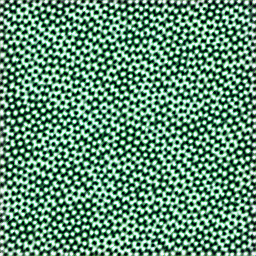
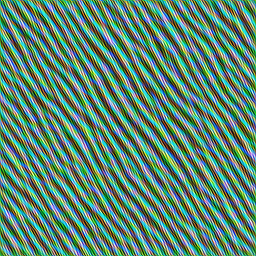
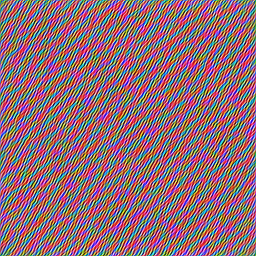
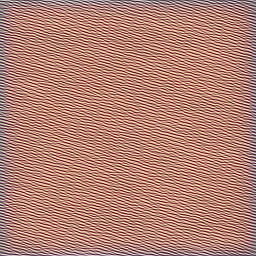

100%|██████████| 512/512 [00:28<00:00, 17.68it/s]



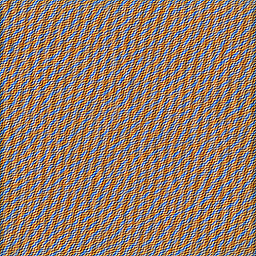
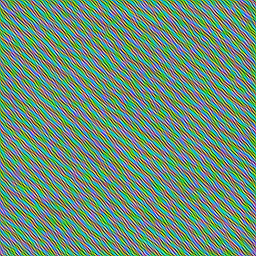
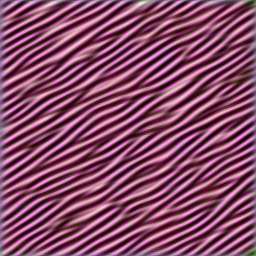
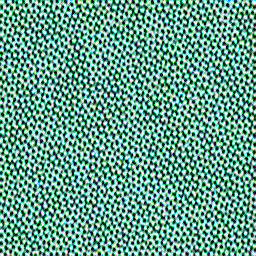

100%|██████████| 512/512 [00:30<00:00, 17.04it/s]



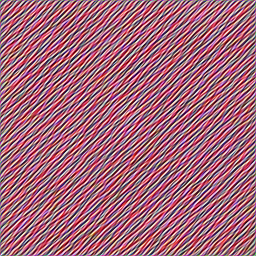
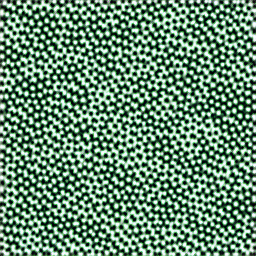
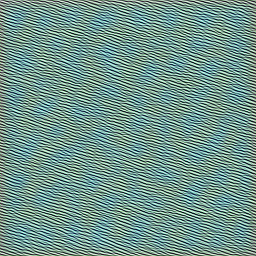
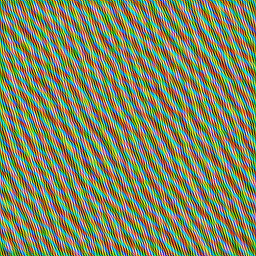

In [8]:
runDiversity('layer1', 24)

runDiversity('layer1_1', 24)

runDiversity('layer1_2', 24)

100%|██████████| 512/512 [00:31<00:00, 16.09it/s]



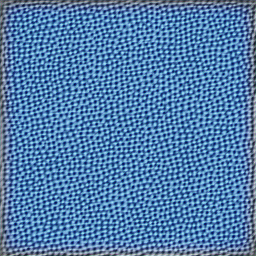
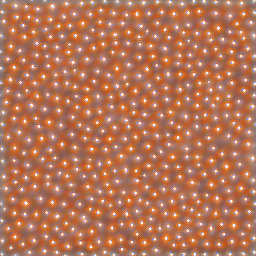
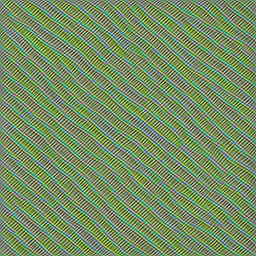
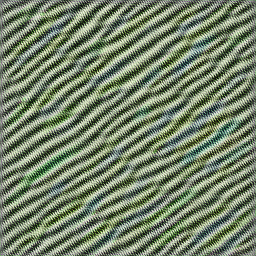

100%|██████████| 512/512 [00:32<00:00, 15.76it/s]



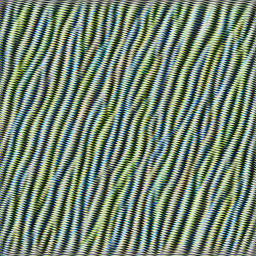
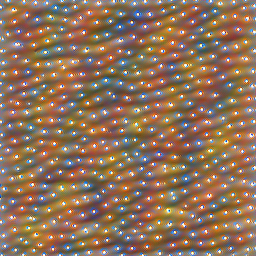
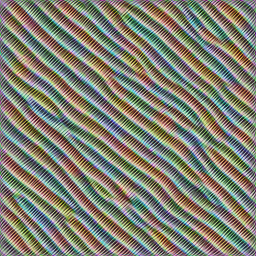
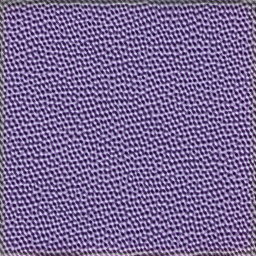

100%|██████████| 512/512 [00:33<00:00, 15.45it/s]



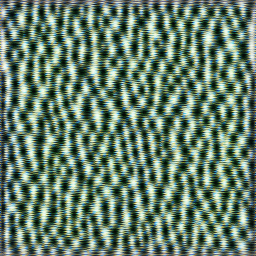
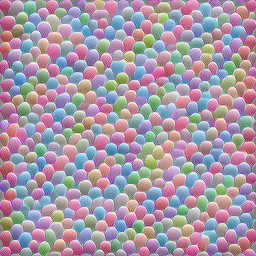
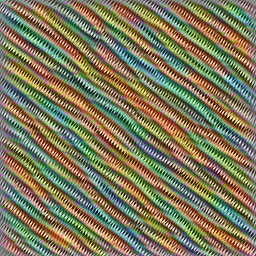
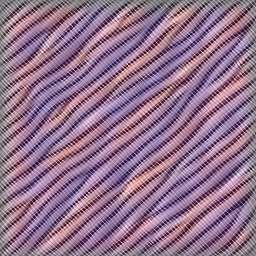

100%|██████████| 512/512 [00:33<00:00, 15.14it/s]



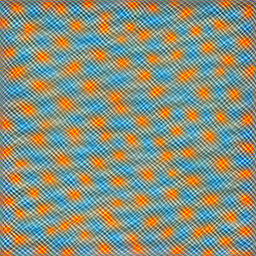
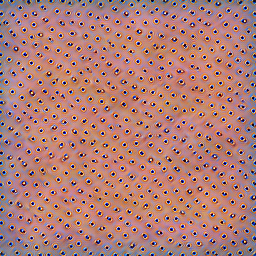
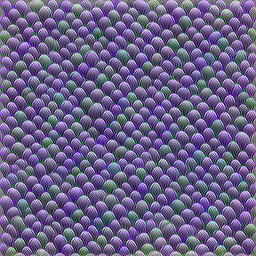
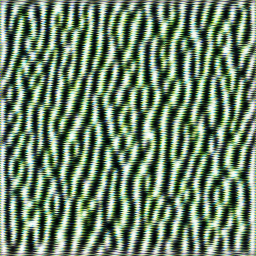

100%|██████████| 512/512 [00:34<00:00, 14.85it/s]



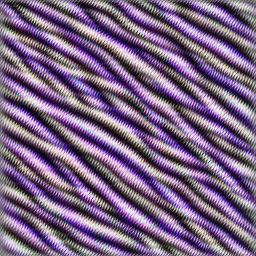
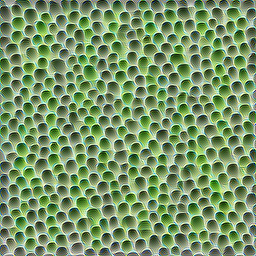
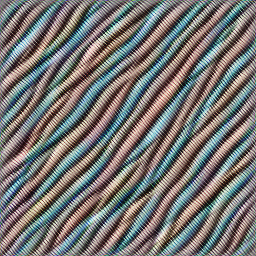
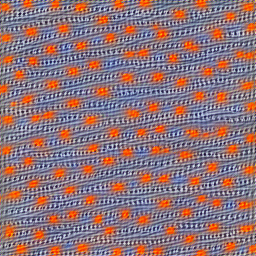

100%|██████████| 512/512 [00:35<00:00, 14.54it/s]



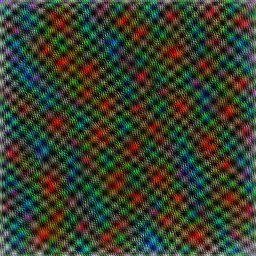
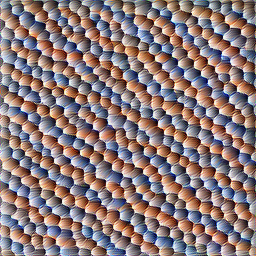
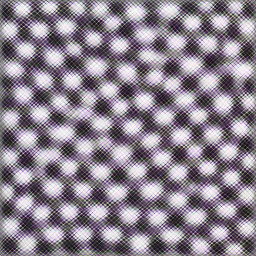
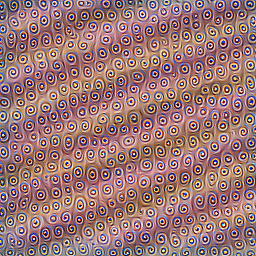

100%|██████████| 512/512 [00:35<00:00, 14.29it/s]



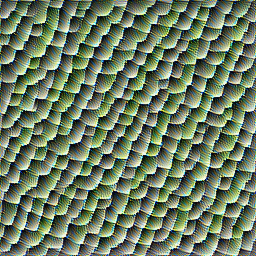
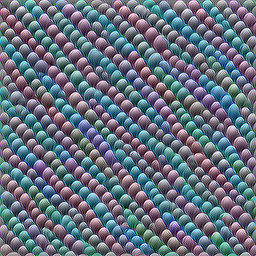
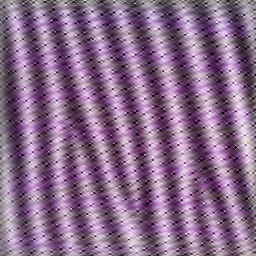
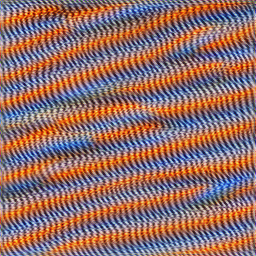

100%|██████████| 512/512 [00:36<00:00, 14.00it/s]



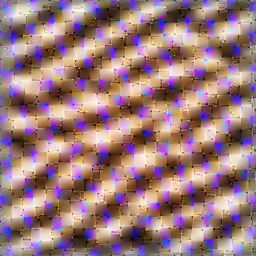
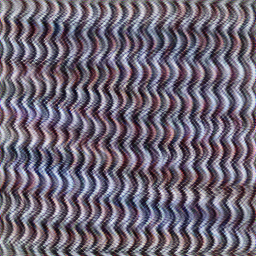
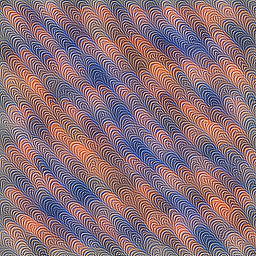
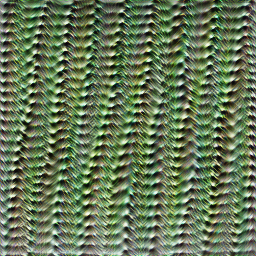

In [9]:
runDiversity('layer2_0', 214)

runDiversity('layer2_1', 234)

runDiversity('layer2_2', 363)

runDiversity('layer2_3', 163)

runDiversity('layer2_4', 214)

runDiversity('layer2_5', 234)

runDiversity('layer2_6', 363)

runDiversity('layer2_7', 163)

100%|██████████| 512/512 [00:40<00:00, 12.62it/s]



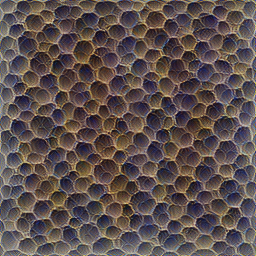
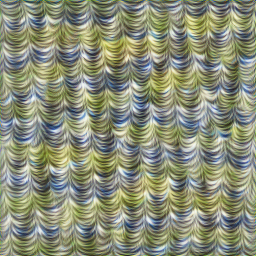
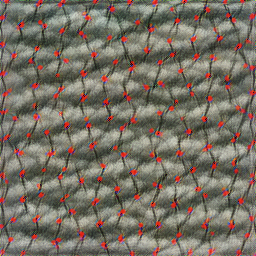
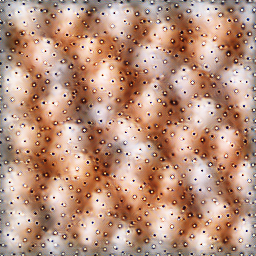

100%|██████████| 512/512 [00:43<00:00, 11.75it/s]



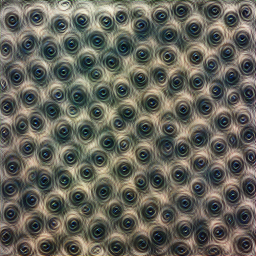
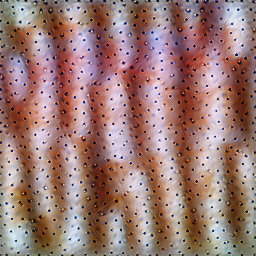
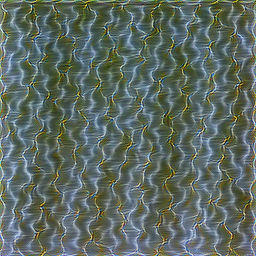
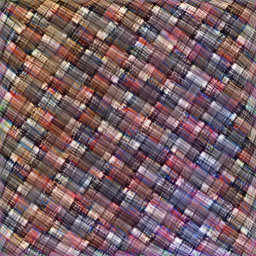

100%|██████████| 512/512 [00:46<00:00, 11.02it/s]



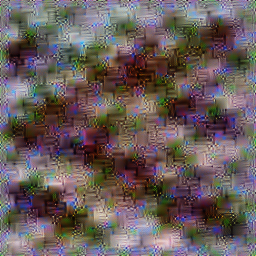
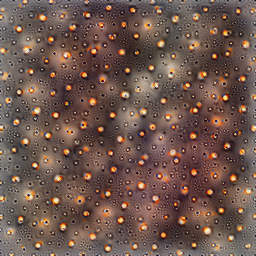
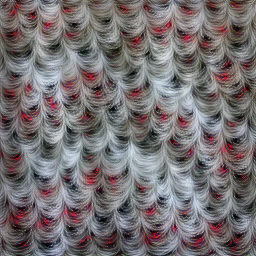
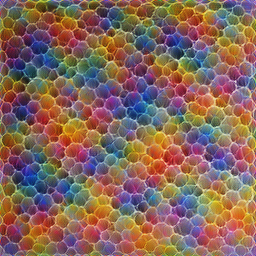

100%|██████████| 512/512 [00:49<00:00, 10.35it/s]



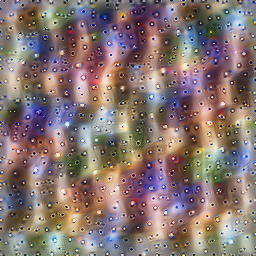
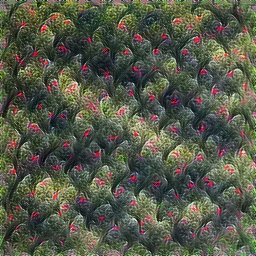
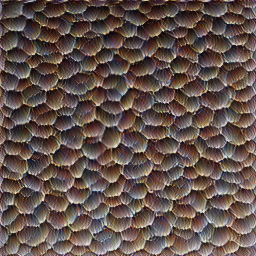
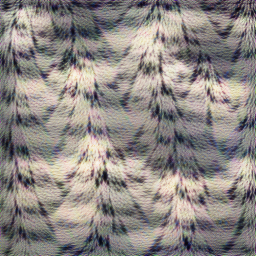

100%|██████████| 512/512 [00:51<00:00,  9.94it/s]



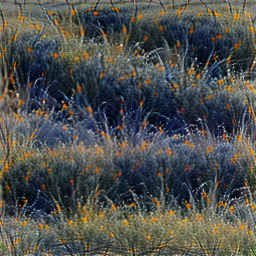
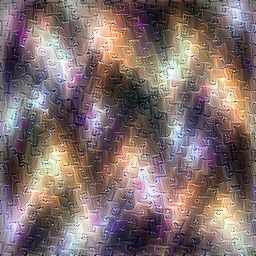
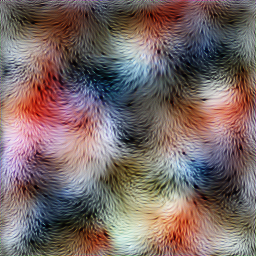
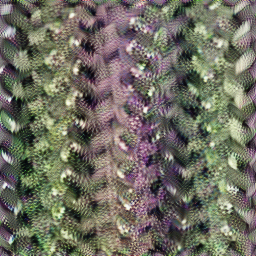

100%|██████████| 512/512 [00:54<00:00,  9.39it/s]



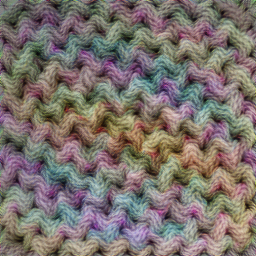
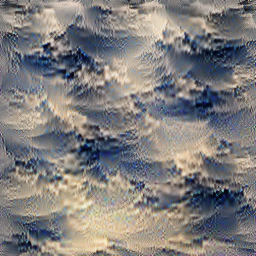
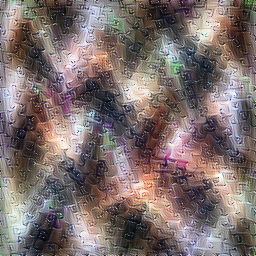
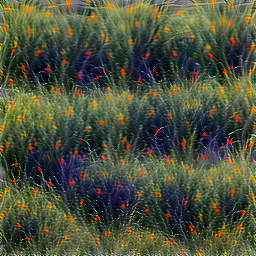

100%|██████████| 512/512 [00:56<00:00,  9.04it/s]



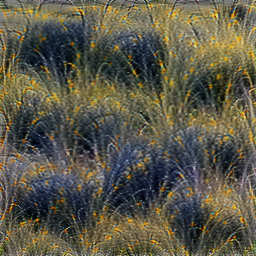
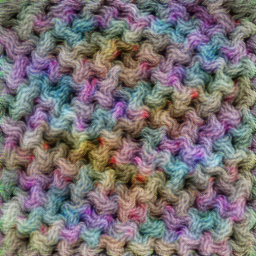
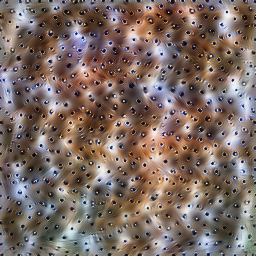
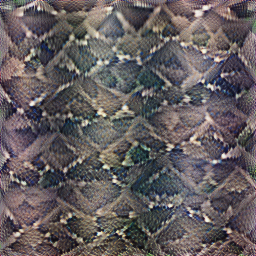

100%|██████████| 512/512 [00:58<00:00,  8.69it/s]



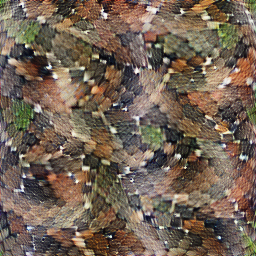
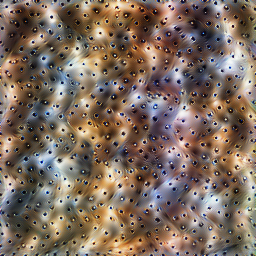
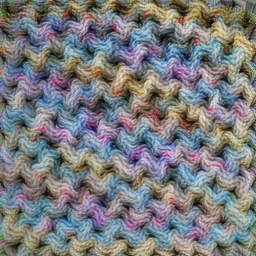
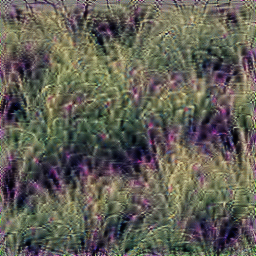

100%|██████████| 512/512 [01:01<00:00,  8.30it/s]



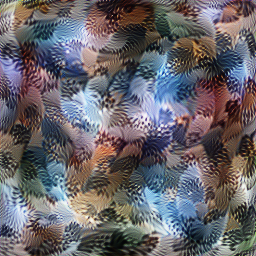
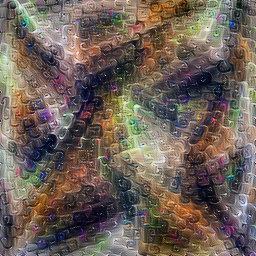
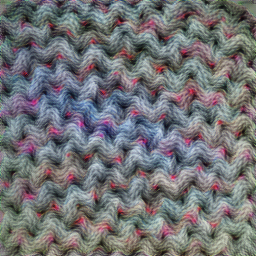
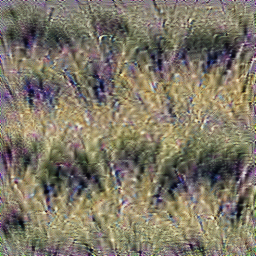

100%|██████████| 512/512 [01:04<00:00,  7.94it/s]



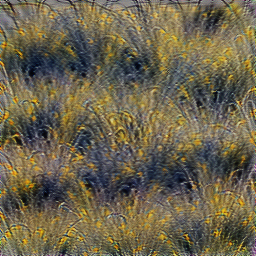
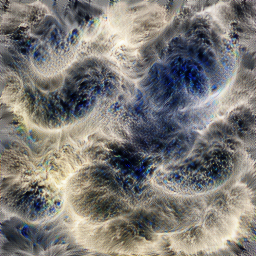
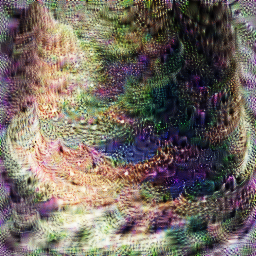
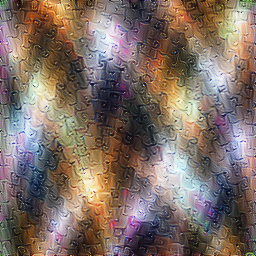

In [10]:
runDiversity('layer3_1', 255)

runDiversity('layer3_5', 123)

runDiversity('layer3_9', 224)

runDiversity('layer3_13', 255)

runDiversity('layer3_16', 123)

runDiversity('layer3_20', 224)

runDiversity('layer3_23', 255)

runDiversity('layer3_26', 123)

runDiversity('layer3_30', 224)

runDiversity('layer3_34', 224)

100%|██████████| 512/512 [01:14<00:00,  6.87it/s]



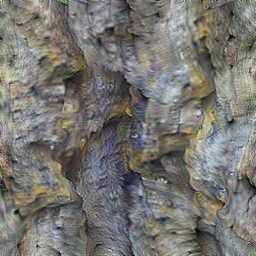
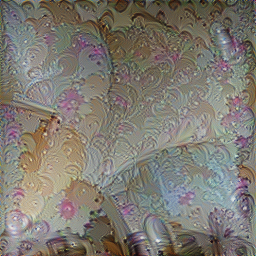
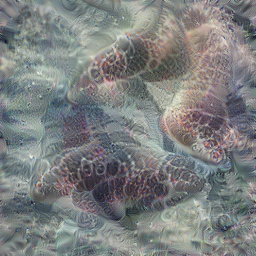
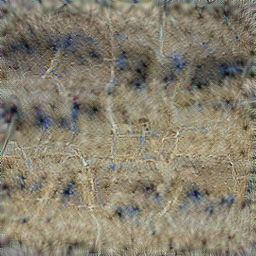

100%|██████████| 512/512 [01:15<00:00,  6.76it/s]



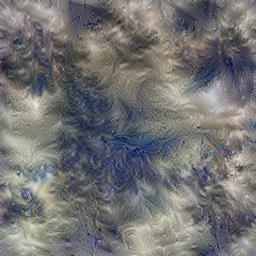
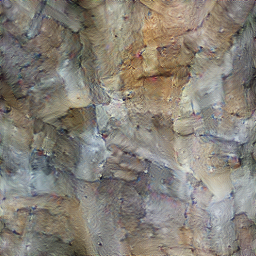
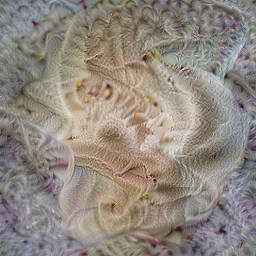
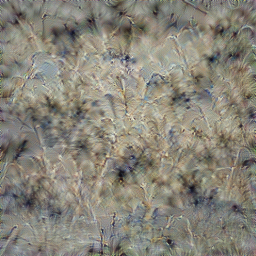

100%|██████████| 512/512 [01:17<00:00,  6.65it/s]



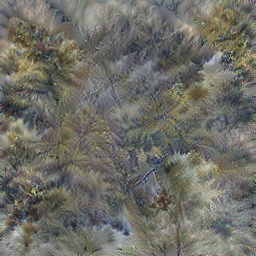
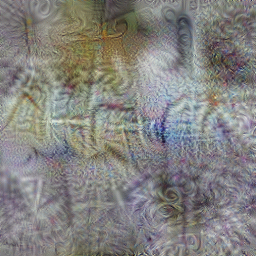
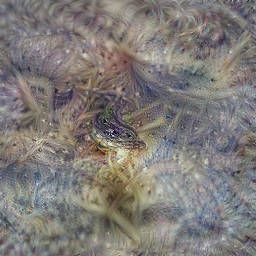
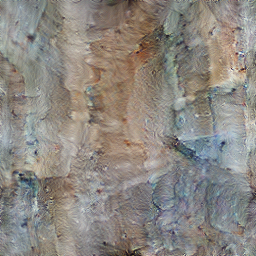

In [12]:
runDiversity('layer4_0', 214)

runDiversity('layer4_1', 435)

runDiversity('layer4_2', 363)

In [35]:
def runDiversitywithTransforms(layerName, layerNeuron, transforms=None, imageSize=256, batch=4, weight=1e2):
    if transforms == None:
        transforms = [
            transform.pad(16),
            transform.jitter(8),
            transform.random_scale([n/100. for n in range(80, 120)]),
            transform.random_rotate(list(range(-10,10)) + list(range(-5,5)) + 10*list(range(-2,2))),
            transform.jitter(2),
        ]
    batch_param_f = lambda: param.image(imageSize, batch=batch)
    obj = objectives.channel(layerName, layerNeuron) - weight * objectives.diversity(layerName)
    _ = render.render_vis(model_, obj, batch_param_f, transforms=transforms, show_inline=True)

100%|██████████| 512/512 [00:43<00:00, 11.71it/s]



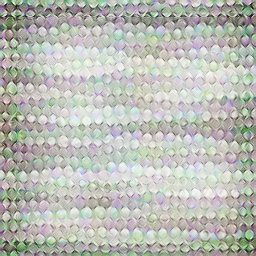
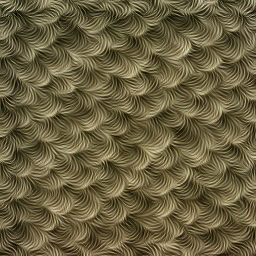
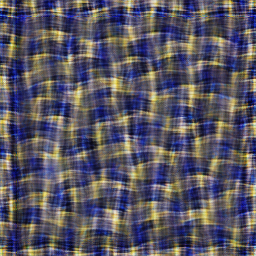
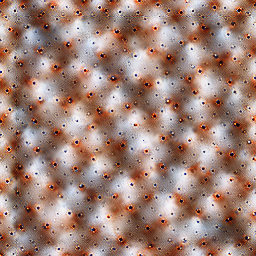

100%|██████████| 512/512 [00:47<00:00, 10.87it/s]



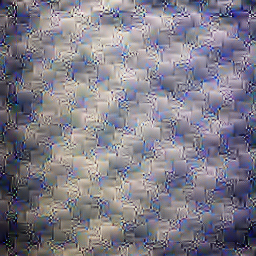
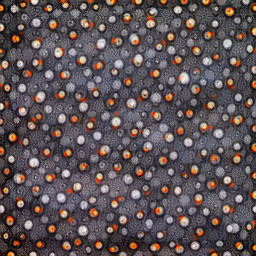
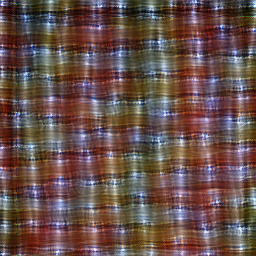
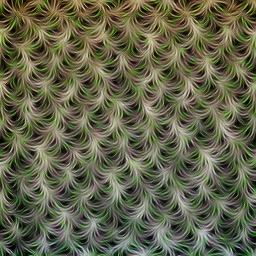

100%|██████████| 512/512 [00:50<00:00, 10.17it/s]



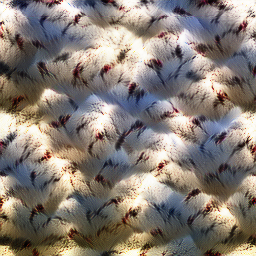
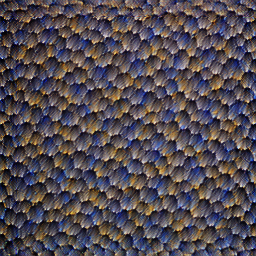
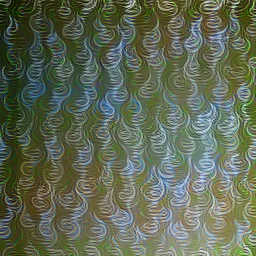
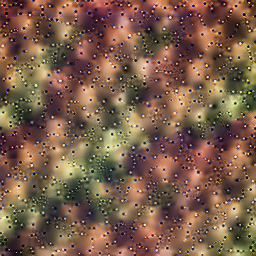

100%|██████████| 512/512 [00:53<00:00,  9.63it/s]



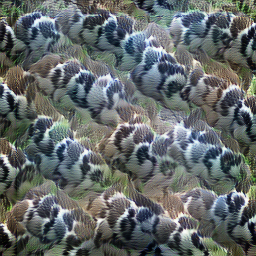
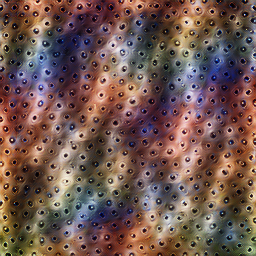
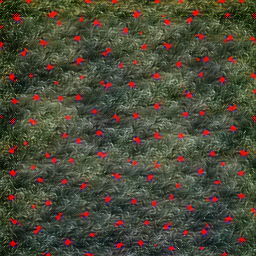
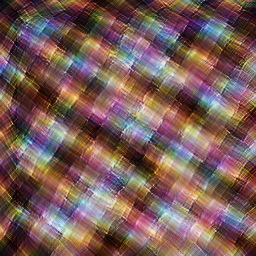

100%|██████████| 512/512 [00:55<00:00,  9.16it/s]



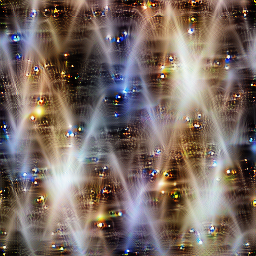
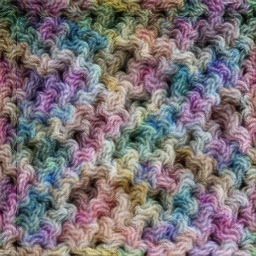
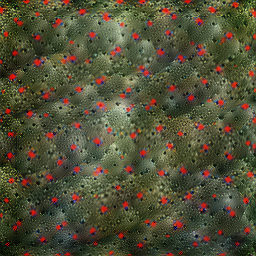
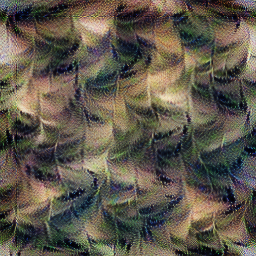

100%|██████████| 512/512 [00:58<00:00,  8.68it/s]



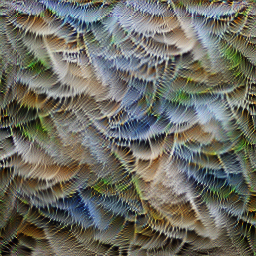
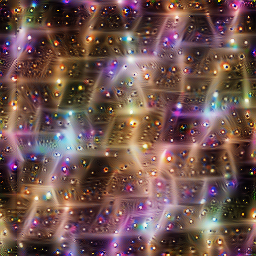
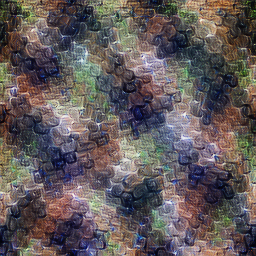
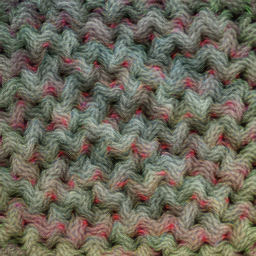

100%|██████████| 512/512 [01:01<00:00,  8.37it/s]



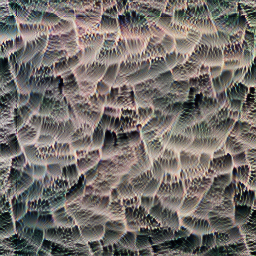
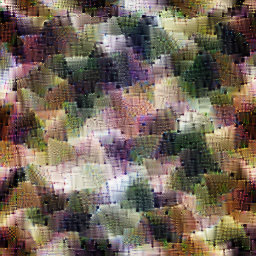
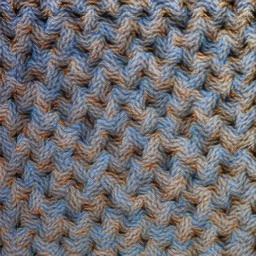
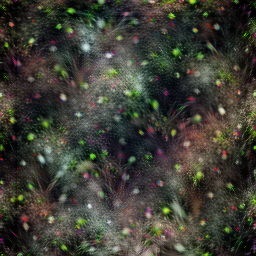

100%|██████████| 512/512 [01:03<00:00,  8.03it/s]



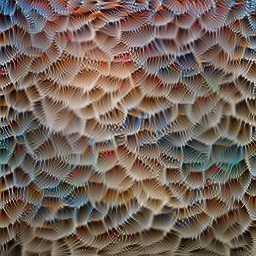
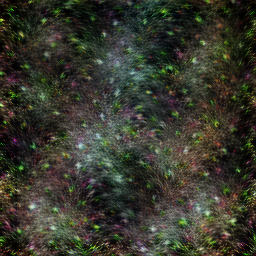
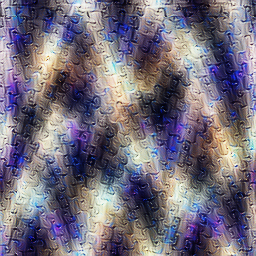
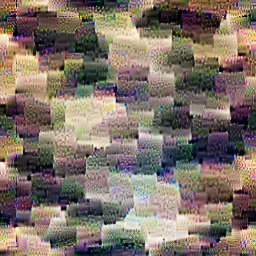

100%|██████████| 512/512 [01:07<00:00,  7.64it/s]



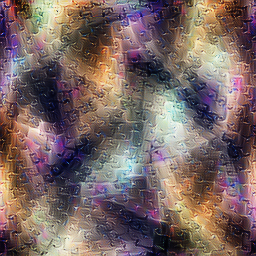
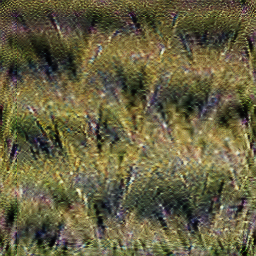
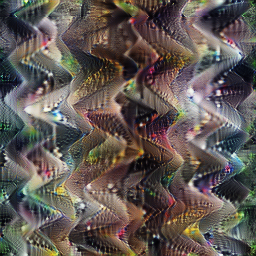
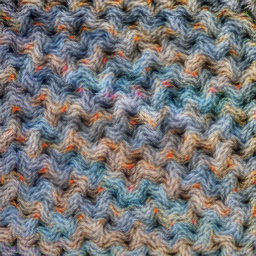

100%|██████████| 512/512 [01:10<00:00,  7.24it/s]



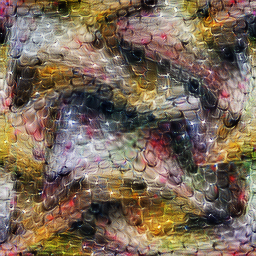
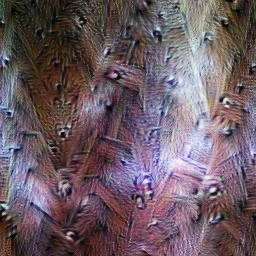
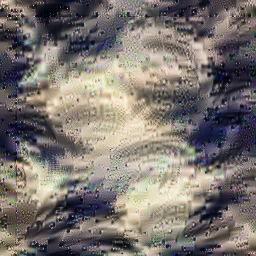
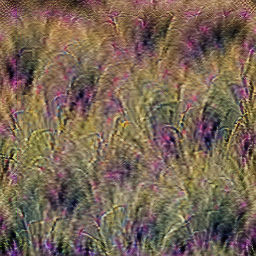

In [36]:
runDiversitywithTransforms('layer3_1', 255)

runDiversitywithTransforms('layer3_5', 123)

runDiversitywithTransforms('layer3_9', 224)

runDiversitywithTransforms('layer3_13', 255)

runDiversitywithTransforms('layer3_16', 123)

runDiversitywithTransforms('layer3_20', 224)

runDiversitywithTransforms('layer3_23', 255)

runDiversitywithTransforms('layer3_26', 123)

runDiversitywithTransforms('layer3_30', 224)

runDiversitywithTransforms('layer3_34', 224)

## Interaction between neurons

In [21]:
def runInteraction(layerName, layerNeuron, model, imageSize=256):
    param_f = lambda: param.image(imageSize, batch=2)
    obj = objectives.channel(layerName, layerNeuron, batch=1) - objectives.channel(layerName, layerNeuron, batch=0)
    _ = render.render_vis(model, obj, param_f, show_inline=True)

100%|██████████| 512/512 [00:31<00:00, 16.20it/s]



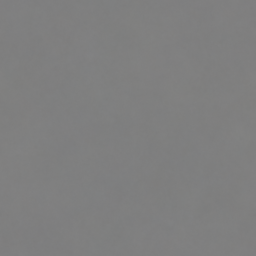
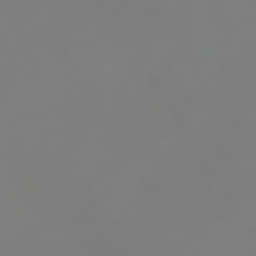

100%|██████████| 512/512 [00:34<00:00, 15.00it/s]



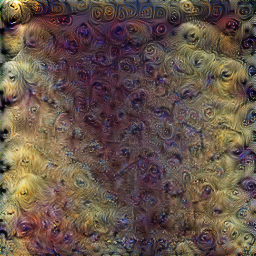
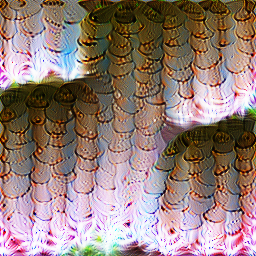

100%|██████████| 512/512 [00:36<00:00, 14.03it/s]



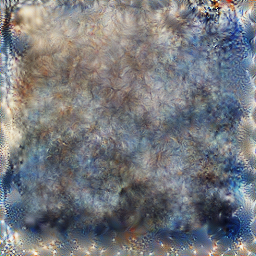
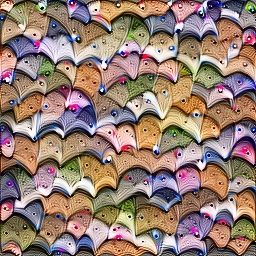

100%|██████████| 512/512 [00:38<00:00, 13.13it/s]



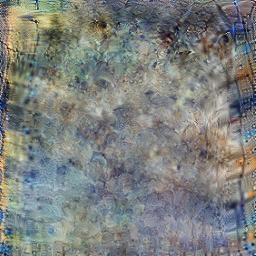
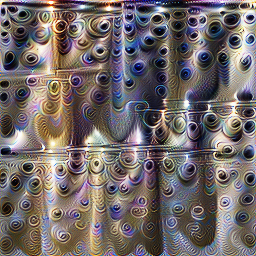

100%|██████████| 512/512 [00:41<00:00, 12.44it/s]



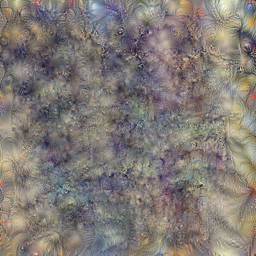
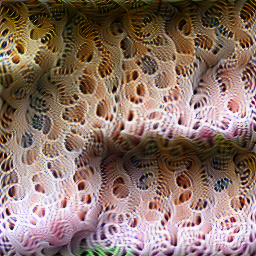

100%|██████████| 512/512 [00:43<00:00, 11.67it/s]



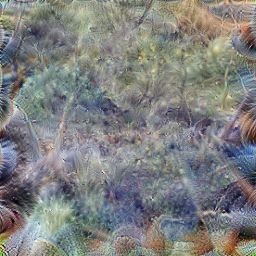
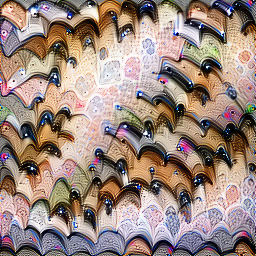

100%|██████████| 512/512 [00:45<00:00, 11.22it/s]



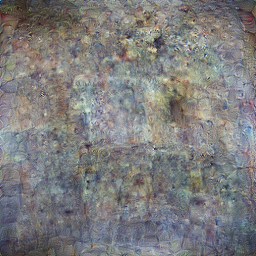
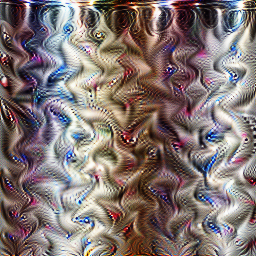

100%|██████████| 512/512 [00:47<00:00, 10.75it/s]



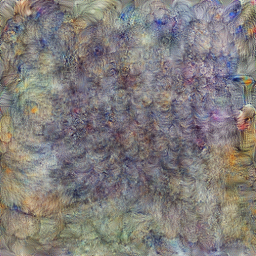
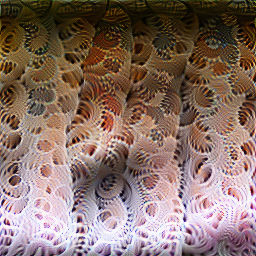

100%|██████████| 512/512 [00:50<00:00, 10.22it/s]



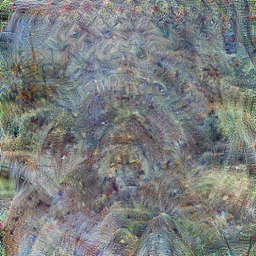
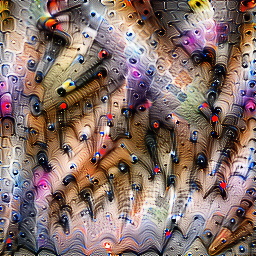

100%|██████████| 512/512 [00:52<00:00,  9.74it/s]



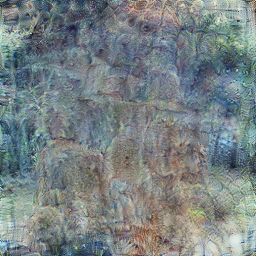
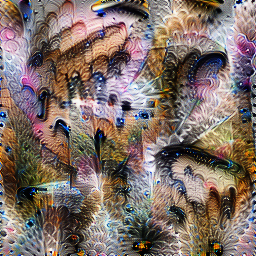

In [24]:
runInteraction('layer3_1', 255, model_)

runInteraction('layer3_5', 123, model_)

runInteraction('layer3_9', 224, model_)

runInteraction('layer3_13', 255, model_)

runInteraction('layer3_16', 123, model_)

runInteraction('layer3_20', 224, model_)

runInteraction('layer3_23', 255, model_)

runInteraction('layer3_26', 123, model_)

runInteraction('layer3_30', 224, model_)

runInteraction('layer3_34', 224, model_)

## Activation grids

Now lets see what the network is looking at over a grid of the image, from a given layer.

In [6]:
@torch.no_grad()
def get_layer(model, layer, X):
    hook = render.ModuleHook(getattr(model, layer))
    model(X)
    hook.close()
    return hook.features


@objectives.wrap_objective()
def dot_compare(layer, acts, batch=1):
    def inner(T):
        pred = T(layer)[batch]
        return -(pred * acts).sum(dim=0, keepdims=True).mean()

    return inner

In [7]:
def render_activation_grid(
    img,
    model,
    layer="mixed4d",
    cell_image_size=60,
    n_groups=6,
    n_steps=1024,
    batch_size=64,
    img_crop_size=224,
    img_resize=512,
    img_transforms=None):
    
    
    # First wee need, to normalize and resize the image
    #img = torch.tensor(np.transpose(img, [2, 0, 1])).to(device)
    #normalize = (transform.normalize())
    #transforms = transform.standard_transforms.copy() + [
    #    normalize,
    #    torch.nn.Upsample(size=image_input_size, mode="bilinear", align_corners=True),
    #]
    #transforms_f = transform.compose(transforms)
    # shape: (1, 3, original height of img, original width of img)
    
    if img_transforms is None:
        img_transforms = transforms.Compose([
                            transforms.Resize(img_resize),
                            transforms.CenterCrop(img_crop_size),
                            transforms.ToTensor(),
                            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])
    
    img = img_transforms(img).to(device)
    img = img.unsqueeze(0)
    # shape: (1, 3, 224, 224)
    #img = transforms_f(img)
    
    

    # Here we compute the activations of the layer `layer` using `img` as input
    # shape: (layer_channels, layer_height, layer_width), the shape depends on the layer
    acts = get_layer(model, layer, img)[0]
    # shape: (layer_height, layer_width, layer_channels)
    acts = acts.permute(1, 2, 0)
    # shape: (layer_height*layer_width, layer_channels)
    acts = acts.view(-1, acts.shape[-1])
    acts_np = acts.cpu().numpy()
    nb_cells = acts.shape[0]

    # negative matrix factorization `NMF` is used to reduce the number
    # of channels to n_groups. This will be used as the following.
    # Each cell image in the grid is decomposed into a sum of
    # (n_groups+1) images. First, each cell has its own set of parameters
    #  this is what is called `cells_params` (see below). At the same time, we have
    # a of group of images of size 'n_groups', which also have their own image parametrized
    # by `groups_params`. The resulting image for a given cell in the grid
    # is the sum of its own image (parametrized by `cells_params`)
    # plus a weighted sum of the images of the group. Each each image from the group
    # is weighted by `groups[cell_index, group_idx]`. Basically, this is a way of having
    # the possibility to make cells with similar activations have a similar image, because
    # cells with similar activations will have a similar weighting for the elements
    # of the group.
    if n_groups > 0:
        reducer = ChannelReducer(n_groups, "NMF")
        groups = reducer.fit_transform(acts_np)
        groups /= groups.max(0)
    else:
        groups = np.zeros([])
    # shape: (layer_height*layer_width, n_groups)
    groups = torch.from_numpy(groups)

    # Parametrization of the images of the groups (we have 'n_groups' groups)
    groups_params, groups_image_f = param.fft_image(
        [n_groups, 3, cell_image_size, cell_image_size]
    )
    # Parametrization of the images of each cell in the grid (we have 'layer_height*layer_width' cells)
    cells_params, cells_image_f = param.fft_image(
        [nb_cells, 3, cell_image_size, cell_image_size]
    )

    # First, we need to construct the images of the grid
    # from the parameterizations

    def image_f():
        groups_images = groups_image_f()
        cells_images = cells_image_f()
        X = []
        for i in range(nb_cells):
            x = 0.7 * cells_images[i] + 0.5 * sum(
                groups[i, j] * groups_images[j] for j in range(n_groups)
            )
            X.append(x)
        X = torch.stack(X)
        return X

    # make sure the images are between 0 and 1
    image_f = param.to_valid_rgb(image_f, decorrelate=True)

    # After constructing the cells images, we sample randomly a mini-batch of cells
    # from the grid. This is to prevent memory overflow, especially if the grid
    # is large.
    def sample(image_f, batch_size):
        def f():
            X = image_f()
            inds = torch.randint(0, len(X), size=(batch_size,))
            inputs = X[inds]
            # HACK to store indices of the mini-batch, because we need them
            # in objective func. Might be better ways to do that
            sample.inds = inds
            return inputs

        return f

    image_f_sampled = sample(image_f, batch_size=batch_size)

    # Now, we define the objective function

    def objective_func(model):
        # shape: (batch_size, layer_channels, cell_layer_height, cell_layer_width)
        pred = model(layer)
        # use the sampled indices from `sample` to get the corresponding targets
        target = acts[sample.inds].to(pred.device)
        # shape: (batch_size, layer_channels, 1, 1)
        target = target.view(target.shape[0], target.shape[1], 1, 1)
        dot = (pred * target).sum(dim=1).mean()
        return -dot

    obj = objectives.Objective(objective_func)

    def param_f():
        # We optimize the parametrizations of both the groups and the cells
        params = list(groups_params) + list(cells_params)
        return params, image_f_sampled

    results = render.render_vis(
        model,
        obj,
        param_f,
        thresholds=(n_steps,),
        show_image=False,
        progress=True,
        fixed_image_size=cell_image_size,
    )
    # shape: (layer_height*layer_width, 3, grid_image_size, grid_image_size)
    imgs = image_f()
    imgs = imgs.cpu().data
    imgs = imgs[:, :, 2:-2, 2:-2]
    # turn imgs into a a grid
    grid = torchvision.utils.make_grid(imgs, nrow=int(np.sqrt(nb_cells)), padding=0)
    grid = grid.permute(1, 2, 0)
    grid = grid.numpy()
    render.show(grid)
    return imgs

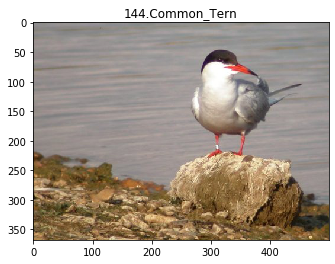

In [8]:
img_id = 4122

img = Image.open(image_datasets['test'].imgs[img_id][0])
plt.figure()
plt.imshow(np.array(img, np.float32)/255.0)
plt.title(class_names[image_datasets['test'].imgs[img_id][1]])
plt.show()

100%|██████████| 1024/1024 [04:52<00:00,  3.50it/s]



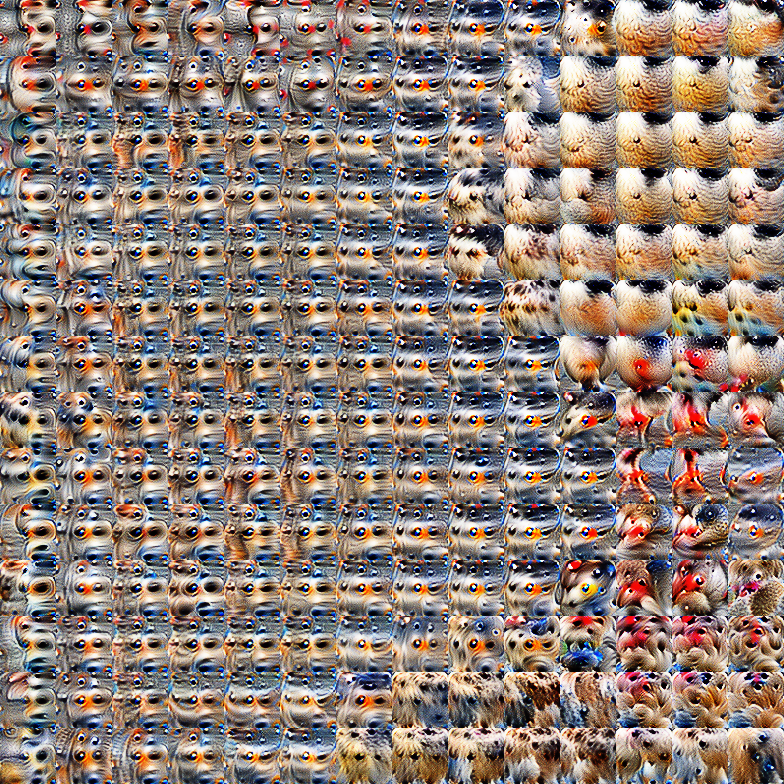

100%|██████████| 1024/1024 [03:13<00:00,  5.30it/s]



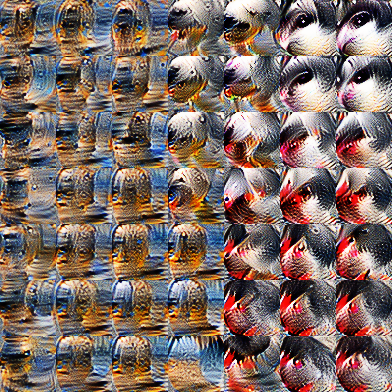

In [9]:
for layerName in ['layer3','layer4']:
    _ = render_activation_grid(img, model_, cell_image_size=60, n_steps=1024, batch_size=64, layer=layerName)

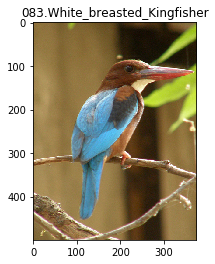

In [8]:
img_id = 2334

img = Image.open(image_datasets['test'].imgs[img_id][0])
plt.figure()
plt.imshow(np.array(img, np.float32)/255.0)
plt.title(class_names[image_datasets['test'].imgs[img_id][1]])
plt.show()

100%|██████████| 1024/1024 [04:51<00:00,  3.51it/s]



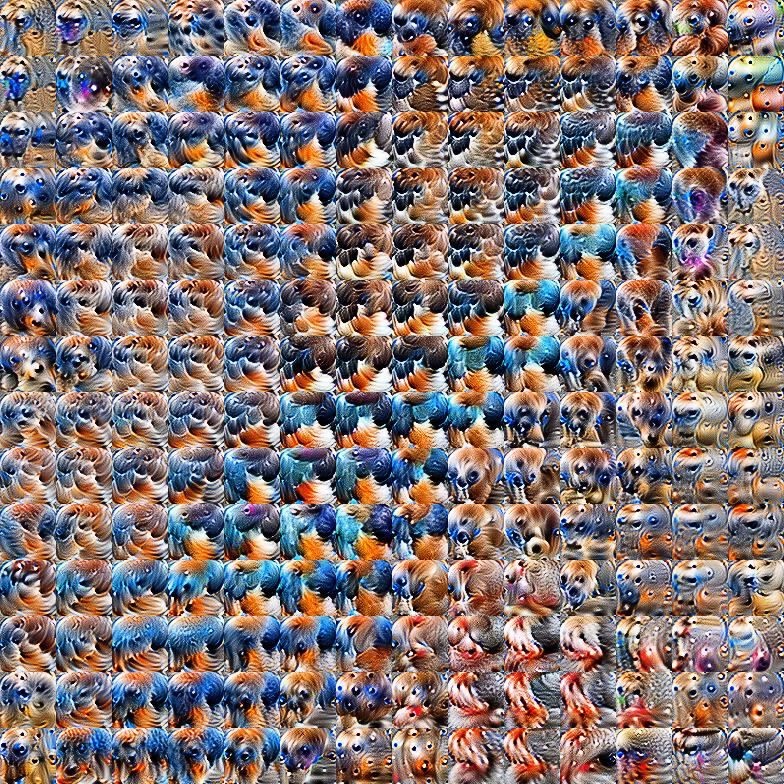

100%|██████████| 1024/1024 [03:13<00:00,  5.30it/s]



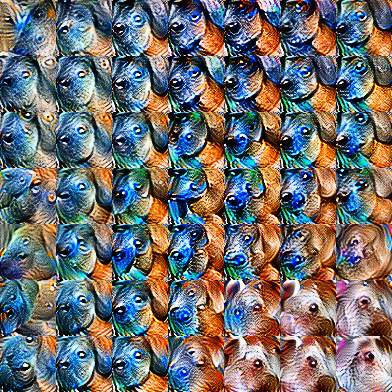

In [9]:
for layerName in ['layer3','layer4']:
    _ = render_activation_grid(img, model_, cell_image_size=60, n_steps=1024, batch_size=64, layer=layerName)